In [1]:
%load_ext autoreload
%autoreload 2

import os
import sys
sys.path.append('/global/homes/q/qmxp55/DESI/omarlibs')
import raichoorlib
import numpy as np
np.seterr(divide='ignore') # ignode divide by zero warnings
import astropy.io.fits as fits
import fitsio
import glob
import healpy as hp
from astropy.coordinates import SkyCoord
import astropy.units as units
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.collections import PatchCollection
from matplotlib.patches import Rectangle

from main_def import get_random, flux_to_mag, get_sweep_whole, bgsmask, getGeoCuts
from photometric_def import get_stars, get_galaxies
from main_def import get_random, hexbin
from geometric_def import LSLGA_veto

import seaborn as sns
sns.set()


## Input files

In [2]:
#dir where we are going to stored the results
pathdir = '/global/homes/q/qmxp55/DESI/bgs_main/bgs_and_LSdr8_GAMA_redshift_in_LSLGA/'
#if results dir does not exist, create it
ispathdir = os.path.isdir(pathdir)
if not ispathdir: os.mkdir(pathdir)

# input files
inptfiles = {}

inptfiles['dr8pix']     = '/project/projectdirs/desi/target/catalogs/dr8/0.31.1/pixweight/pixweight-dr8-0.31.1.fits'
inptfiles['dr8maskbitsource'] = '/global/cscratch1/sd/qmxp55/sweep_files/dr8_sweep_whole_maskbitsource.npy'
inptfiles['gama_dr3'] = '/global/cscratch1/sd/qmxp55/TilingCatv46.fits'
inptfiles['lslga'] = '/global/cscratch1/sd/qmxp55/LSLGA-v2.0.fits'

for file in inptfiles.keys():
    print(file, '\t=', inptfiles[file])


dr8pix 	= /project/projectdirs/desi/target/catalogs/dr8/0.31.1/pixweight/pixweight-dr8-0.31.1.fits
dr8maskbitsource 	= /global/cscratch1/sd/qmxp55/sweep_files/dr8_sweep_whole_maskbitsource.npy
gama_dr3 	= /global/cscratch1/sd/qmxp55/TilingCatv46.fits
lslga 	= /global/cscratch1/sd/qmxp55/LSLGA-v2.0.fits


The input files needed for this notebook are:

* dr8randroot: the randoms of LS DR8 created by DESITARGET. These are divided into 10 fits files each one with a target density of 5000. For more info go to: http://legacysurvey.org/dr8/files/#random-catalogs
* dr8pix: the healpix pixel weights map. Includes information such as the stellar density from GAIA DR2, the extinction, the psfsizes and galdepths for the three bands.
* desitile: the tiles pattern for the DESI footprint (~14000 deg^2). Includes tiles centers.
* bgssvdr8: the BGS SV catalogue. Include the DESITARGET columns to select the supersets and magnitudes in the three bands plus the fiber magnitude in the r-band.

In [3]:
gama_ = fitsio.read(inptfiles['gama_dr3'], ext=1)
# get only good quality gama objects
gama = gama_[(gama_['SURVEY_CLASS'] >= 4) & (gama_['NQ'] >= 3)]
print('fraction of gama good quality: %i / %i' %(len(gama), len(gama_)))

fraction of gama good quality: 186137 / 221373


In [4]:
def get_isgama(ra, dec):
    
    keep = np.zeros_like(ra, dtype='?')

    #keep |= ((ra > 30.2) & (ra < 38.8) & (dec > -10.2) & (dec < -3.72)) #G02
    keep |= ((ra > 174.) & (ra < 186.) & (dec > -3.) & (dec < 2.)) #G12
    keep |= ((ra > 211.5) & (ra < 223.5) & (dec > -2.) & (dec < 3.)) #G15
    keep |= ((ra > 129.) & (ra < 141.) & (dec > -2.) & (dec < 3.)) #G09
    
    return keep


In [5]:
# load catalogue
# this is dr8 sweeps in decals with BGSBITS 
cat =  get_sweep_whole(dr='dr8-south', rlimit=20, maskbitsource=False, bgsbits=True, opt='1')


sweep file already exist at:/global/cscratch1/sd/qmxp55/sweep_files/dr8-south_sweep_whole_rlimit_20.npy
Total run time: 0.014718 sec


In [6]:
# get boolean of LS dr8 in GAMA DR3
catisgama = get_isgama(cat['RA'], cat['DEC'])

## Match BGS catalogue with GAMA DR3

In [7]:
# dr8 in gama
dr8ingama = cat[catisgama]

In [8]:
#
from main_def import bgsmask
# bgs mask
# since the aim is to analyse targets with the LG bit, our BGS catalogue doesn't include the masking around the LG.
bgs = np.ones_like(dr8ingama['RA'], dtype='?')
for key, val in zip(bgsmask().keys(), bgsmask().values()):
    if (key == 'allmask') or (key == 'MS') or (key == 'LG'): continue
    else: bgs &= (dr8ingama['BGSBITS'] & 2**(val)) != 0
#bgs = (dr8ingama['BGSBITS'] & 2**(15)) != 0
print('fraction of bgs in dr8 within GAMA: %i / %i' %(np.sum(bgs), len(dr8ingama)))

lgbit = np.ones_like(dr8ingama['RA'], dtype='?')
lgbit &= (dr8ingama['BGSBITS'] & 2**(bgsmask()['LG'])) != 0


fraction of bgs in dr8 within GAMA: 255383 / 868485


In [37]:
dr8ingama.dtype.names

('TYPE',
 'RA',
 'DEC',
 'GMAG',
 'RMAG',
 'ZMAG',
 'FLUX_IVAR_G',
 'FLUX_IVAR_R',
 'FLUX_IVAR_Z',
 'NOBS_G',
 'NOBS_R',
 'NOBS_Z',
 'FRACFLUX_G',
 'FRACFLUX_R',
 'FRACFLUX_Z',
 'FRACMASKED_G',
 'FRACMASKED_R',
 'FRACMASKED_Z',
 'FRACIN_G',
 'FRACIN_R',
 'FRACIN_Z',
 'RFIBERMAG',
 'REF_CAT',
 'REF_ID',
 'G',
 'AEN',
 'MASKBITS',
 'FLUX_R',
 'BGSBITS')

### I tought all objects with the LG bit set on where fitted by PSF only? Below we can see these objects are being fitted by all morphologies

In [99]:
#
print('morphos for objects in the LS DR8 within the GAMA footprint and with LG bit set on')
for i in ['COMP', 'DEV ', 'EXP ', 'PSF ', 'REX ']:
    morph = dr8ingama['TYPE'] == i
    LG = ((np.uint64(dr8ingama['MASKBITS']) & np.uint64(2**12))!=0)
    L2 = dr8ingama['REF_CAT'] != 'L2'
    print(i, ':', np.sum((LG) & (morph) & (L2)))
    

morphos for objects in the LS DR8 within the GAMA footprint and with LG bit set on
COMP : 1
DEV  : 4
EXP  : 171
PSF  : 1033
REX  : 62


In [10]:
# matching LS8 with gama
idx2, idx1, d2d, d_ra, d_dec = raichoorlib.match_coord(dr8ingama['RA'], dr8ingama['DEC'], gama['RA'], gama['DEC'], search_radius=0.5)

Doubly matched objects = 0
Final matched objects = 180202


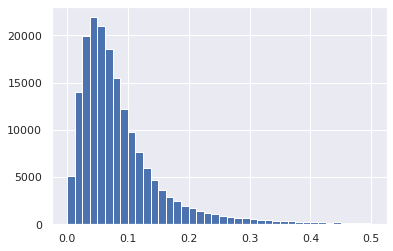

In [57]:
plt.hist(d2d, 40)
plt.show()

## apply Large Galaxy veto to LSdr8 and to GAMA

In [12]:
lslga = fitsio.read(inptfiles['lslga'])
# get LSLGA objects within GAMA only
lslga = lslga[get_isgama(lslga['RA'], lslga['DEC'])]

In [13]:

def get_lslga_veto(CAT=None, lslgacat=None, ref=None):
    
    lg_dr8_path = pathdir+'LG_veto_'+ref+'.npy'
    islg_dr8 = os.path.isfile(lg_dr8_path)

    if islg_dr8:
        lg_dr8 = np.load(lg_dr8_path)
        print('Large Galaxy veto already exist...')
    else:
        lg_dr8 = LSLGA_veto(CAT, lslgacat)
        np.save(lg_dr8_path, lg_dr8)
            
    return lg_dr8


In [14]:
# get LG veto for dr8ingama
lg_dr8ingama = get_lslga_veto(CAT=dr8ingama, lslgacat=lslga, ref='dr8ingama')


Large Galaxy veto already exist...


In [15]:
# get LG veto for GAMA
lg_gama = get_lslga_veto(CAT=gama, lslgacat=lslga, ref='gama')


Large Galaxy veto already exist...


In [16]:
# bgs matched with gama
dr8_gama = np.zeros_like(dr8ingama['RA'], dtype='?') #dr8 that match with gama
dr8_z = np.full_like(dr8ingama['RA'], -1) #z from gama
dr8_rmodel = dr8_z.copy() #r model mag from gama
dr8_sclass = dr8_z.copy() #survey class from gama
dr8_nq = dr8_z.copy() #quality of redshift from gama

dr8_gama[idx2.tolist()] = True
dr8_z[idx2.tolist()] = gama['Z'][idx1]
dr8_rmodel[idx2.tolist()] = gama['R_PETRO'][idx1]
dr8_sclass[idx2.tolist()] = gama['SURVEY_CLASS'][idx1]
dr8_nq[idx2.tolist()] = gama['NQ'][idx1]

# gama matched with bgs
gama_dr8 = np.zeros_like(gama['Z'], dtype='?')
gama_bgs = gama_dr8.copy()
gama_dr8[idx1.tolist()] = True
gama_bgs[idx1.tolist()] = bgs[idx2]


In [86]:
# making a common catalogue
from astropy.table import Table, vstack
Tdr8 = Table()
Tgama = Table()

Tdr8['dr8'] = np.ones_like(dr8ingama['RA'], dtype='?')
Tdr8['gama'] = dr8_gama
Tdr8['bgs'] = bgs
Tdr8['lg'] = lg_dr8ingama
Tdr8['Z'] = dr8_z
Tdr8['rpetro'] = dr8_rmodel
Tdr8['lgbit'] = ~lgbit*1
for i in ['RA', 'DEC', 'TYPE']:
    Tdr8[i] = dr8ingama[i]

notingama = np.zeros(np.sum(~gama_dr8), dtype='?')
Tgama['dr8'] = notingama
Tgama['gama'] = ~notingama
Tgama['bgs'] = notingama
Tgama['lg'] = lg_gama[~gama_dr8]
Tgama['Z'] = gama['Z'][~gama_dr8]
Tgama['rpetro'] = gama['R_PETRO'][~gama_dr8]
Tgama['lgbit'] = np.full(len(notingama), -1)
for i in ['RA', 'DEC']:
    Tgama[i] = gama[i][~gama_dr8]
Tgama['TYPE'] = np.full(len(notingama), 'None')

tab = vstack([Tdr8, Tgama])


In [87]:
tab

dr8,gama,bgs,lg,Z,rpetro,lgbit,RA,DEC,TYPE
bool,bool,bool,bool,float64,float64,int64,float64,float64,str4
True,False,False,False,-1.0,-1.0,0,222.43359901411554,0.3791349979572856,PSF
True,False,False,False,-1.0,-1.0,0,222.43051063950324,0.37745567632345295,PSF
True,False,False,False,-1.0,-1.0,0,222.38292473702893,0.37884607524913355,PSF
True,True,False,False,0.08044999837875366,16.85366439819336,0,222.38628289789324,0.37674945690817746,PSF
True,True,True,False,0.3378399908542633,19.694637298583984,0,222.32112834965392,0.38135718716890454,EXP
True,False,False,False,-1.0,-1.0,0,222.27715132901713,0.37932255275979215,PSF
True,False,True,False,-1.0,-1.0,0,222.33232321656257,0.3814333850599297,DEV
True,False,True,False,-1.0,-1.0,0,222.34003929009057,0.37933246217387195,REX
True,False,False,False,-1.0,-1.0,0,222.35568413692857,0.3963913029956532,PSF


In [19]:
from matplotlib_venn import venn3, venn3_circles
def plot_venn3(A, B, C, norm=None, labels=None):
    '''inputs A, B, C must booleans.'''
    
    A1 = A
    B1 = B
    C1 = C
    AB = (A1) & (B1)
    AC = (A1) & (C1)
    BC = (B1) & (C1)
    ABC = (A1) & (B1) & (C1)
            
    if norm is None: norm, sf = 1, 1
    else: sf = 1
        
    a1 = round((np.sum(A1) - np.sum(AB) - np.sum(AC) + np.sum(ABC))/norm, sf)
    a2 = round((np.sum(B1) - np.sum(AB) - np.sum(BC) + np.sum(ABC))/norm, sf)
    a3 = round((np.sum(AB) - np.sum(ABC))/norm, sf)
    a4 = round((np.sum(C1) - np.sum(AC) - np.sum(BC) + np.sum(ABC))/norm, sf)
    a5 = round((np.sum(AC) - np.sum(ABC))/norm, sf)
    a6 = round((np.sum(BC) - np.sum(ABC))/norm, sf)
    a7 = round(np.sum(ABC)/norm, sf)
        
    if labels is None: labels = ['Group A', 'Group B', 'Group C']
        
    plt.figure(figsize=(7,7))
    v=venn3([a1, a2, a3, a4, a5, a6, a7], set_labels = (labels[0], labels[1], labels[2]))
    c=venn3_circles([a1, a2, a3, a4, a5, a6, a7], linestyle='dotted', linewidth=1, color="grey")
    #c[1].set_lw(1.0)
    c[1].set_ls('solid')
    c[2].set_ls('dashed')
    #c[1].set_color('skyblue')

    plt.show()

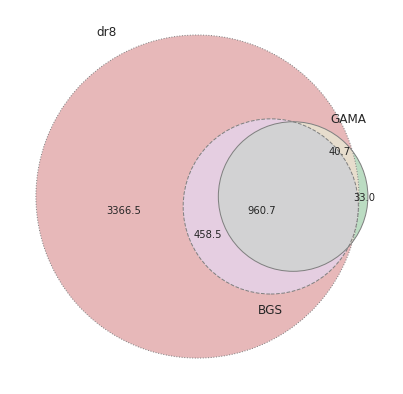

In [20]:
#
A = 59.98*3
plot_venn3(A=tab['dr8'], B=tab['gama'], C=tab['bgs'], norm=A, labels=['dr8', 'GAMA', 'BGS'])


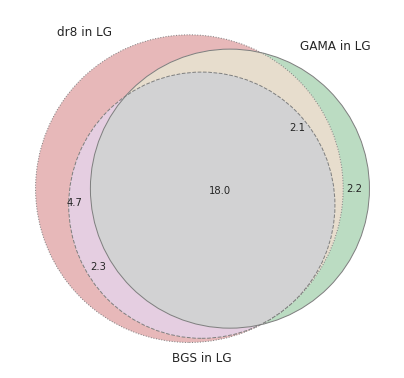

In [21]:
#
A = 59.98*3
plot_venn3(A=((tab['dr8']) & (tab['lg'])), B=((tab['gama']) & (tab['lg'])), C=((tab['bgs']) & (tab['lg'])), norm=A, labels=['dr8 in LG', 'GAMA in LG', 'BGS in LG'])


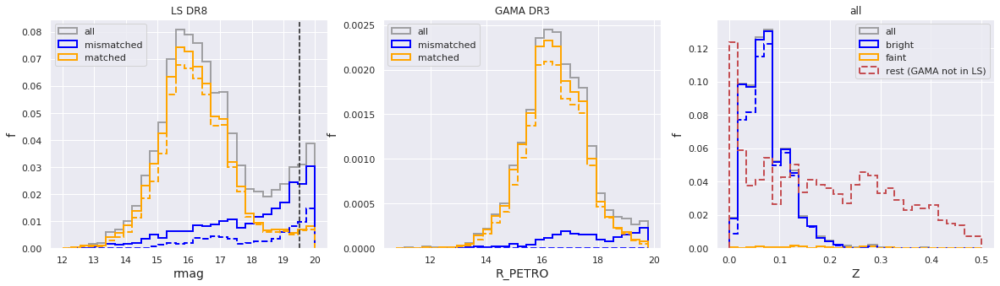

In [22]:
plt.figure(figsize=(20,5))
N = np.sum(tab['lg'])
cumu = False
plt.subplot(1,3,1)
bins = np.linspace(12, 20, 30)
plt.title(r'LS DR8')
plt.hist(dr8ingama['RMAG'][lg_dr8ingama], bins=bins, weights=np.full(np.sum(lg_dr8ingama), 1/N), histtype='step',cumulative=cumu, lw=2, color='gray', alpha=0.7, label='all')
plt.hist(dr8ingama['RMAG'][(~dr8_gama) & (lg_dr8ingama)], bins=bins, weights=np.full(np.sum((~dr8_gama) & (lg_dr8ingama)), 1/N), histtype='step', cumulative=cumu, lw=2, color='blue', label='mismatched')
plt.hist(dr8ingama['RMAG'][(dr8_gama) & (lg_dr8ingama)], bins=bins, weights=np.full(np.sum((dr8_gama) & (lg_dr8ingama)), 1/N), histtype='step',cumulative=cumu, lw=2, color='orange', label='matched')
plt.hist(dr8ingama['RMAG'][(~dr8_gama) & (bgs) & (lg_dr8ingama)], bins=bins, weights=np.full(np.sum((~dr8_gama) & (bgs) & (lg_dr8ingama)), 1/N), histtype='step', cumulative=cumu, lw=2, ls='--', color='blue')
plt.hist(dr8ingama['RMAG'][(dr8_gama) & (bgs) & (lg_dr8ingama)], bins=bins, weights=np.full(np.sum((dr8_gama) & (bgs) & (lg_dr8ingama)), 1/N), histtype='step',cumulative=cumu, lw=2, ls='--', color='orange')
plt.xlabel(r'rmag', size=14)
plt.ylabel(r'f', size=14)
plt.legend(loc='upper left')
plt.axvline(19.5, ls='--', c='k')

plt.subplot(1,3,2)
Ng = len(gama['R_PETRO'])
ylim = np.percentile(gama['R_PETRO'][(gama['R_PETRO'] > 0) & (np.isfinite(gama['R_PETRO']))],(0,99.5))
mask0 = (gama['R_PETRO'] > ylim[0]) & (gama['R_PETRO'] < ylim[1]) & (lg_gama)
bins = np.linspace(ylim[0], ylim[1], 30)
plt.title(r'GAMA DR3')
plt.hist(gama['R_PETRO'][mask0], bins=bins, weights=np.full(np.sum(mask0), 1/Ng), histtype='step',cumulative=cumu, lw=2, color='gray', alpha=0.7, label='all')
plt.hist(gama['R_PETRO'][(mask0) & (~gama_dr8)], bins=bins, weights=np.full(np.sum((mask0) & (~gama_dr8)), 1/Ng), histtype='step', cumulative=cumu, lw=2, color='blue',label='mismatched')
plt.hist(gama['R_PETRO'][(mask0) & (gama_dr8)], bins=bins, weights=np.full(np.sum((mask0) & (gama_dr8)), 1/Ng), histtype='step',cumulative=cumu, lw=2, color='orange',label='matched')
plt.hist(gama['R_PETRO'][(mask0) & (~gama_dr8) & (gama_bgs)], bins=bins, weights=np.full(np.sum((mask0) & (~gama_dr8) & (gama_bgs)), 1/Ng), histtype='step', cumulative=cumu, lw=2, ls='--', color='blue')
plt.hist(gama['R_PETRO'][(mask0) & (gama_dr8) & (gama_bgs)], bins=bins, weights=np.full(np.sum((mask0) & (gama_dr8) & (gama_bgs)), 1/Ng), histtype='step',cumulative=cumu, lw=2, ls='--', color='orange')
plt.xlabel(r'R_PETRO', size=14)
plt.ylabel(r'f', size=14)
plt.legend(loc='upper left')
#plt.axvline(19.5, ls='--', c='k')

plt.subplot(1,3,3)
mask = (dr8_gama) & (dr8_z > 0) & (dr8_z < 1) & (lg_dr8ingama)
maskB = (mask) & (dr8ingama['RMAG'] < 19.5)
maskF = (mask) & (dr8ingama['RMAG'] > 19.5) & (dr8ingama['RMAG'] < 20.)
bins = np.linspace(0,0.5,30)

plt.title(r'all')
plt.hist(dr8_z[mask], bins=bins,  weights=np.full(np.sum(mask), 1/N), histtype='step', cumulative=cumu, lw=2, color='gray', alpha=0.7, label='all')
plt.hist(dr8_z[maskB], bins=bins,  weights=np.full(np.sum(maskB), 1/N), histtype='step', cumulative=cumu, lw=2, color='blue', label='bright')
plt.hist(dr8_z[maskF], bins=bins,  weights=np.full(np.sum(maskF), 1/N), histtype='step', cumulative=cumu, lw=2, color='orange', label='faint')
plt.hist(dr8_z[(maskB) & (bgs)], bins=bins,  weights=np.full(np.sum((maskB) & (bgs)), 1/N), histtype='step', cumulative=cumu, lw=2, ls='--', color='blue')
plt.hist(dr8_z[(maskF) & (bgs)], bins=bins,  weights=np.full(np.sum((maskF) & (bgs)), 1/N), histtype='step', cumulative=cumu, lw=2, ls='--', color='orange')
plt.hist(gama['Z'][~gama_dr8], bins=bins, weights=np.full(np.sum(~gama_dr8), 1/N), histtype='step', cumulative=cumu, lw=2, ls='--', color='r', label='rest (GAMA not in LS)')
plt.xlabel(r'Z', size=14)
plt.ylabel(r'f', size=14)
plt.legend()


# Gallery

In [23]:
def inLSLGA(CAT=None, LSLGA=None, LSLGA_MASK=None):
    '''
    Match BGS cat with LSLGA
    
    Inputs:
    -------
    MASK: array:boolean:: Boolen array with LSLGA size
    
    Returns:
    -------
    idx1: array: int:: BGS Index array of matched objects
    radius_LG: 3D-array: float:: BGS array-like (same lenght as BGS) of LSLGA major, minor and angle params
    '''
    
    if LSLGA_MASK is None:
        LSLGA_MASK = np.ones(len(LSLGA), bool)
        
    idx2, idx1, d2d, d_ra, d_dec = raichoorlib.search_around(LSLGA['RA'][LSLGA_MASK], LSLGA['DEC'][LSLGA_MASK], CAT['RA'], 
                                             CAT['DEC'], search_radius=0.3)
    
    major = np.zeros(len(CAT), float)
    minor = np.zeros(len(CAT), float)
    angle = np.zeros(len(CAT), float)

    major[idx1] = LSLGA['D25'][LSLGA_MASK][idx2]/2./60.
    minor[idx1] = major[idx1]*LSLGA[LSLGA_MASK]['BA'][idx2]
    angle[idx1] = 90 - LSLGA['PA'][LSLGA_MASK][idx2]
    
    radius_LG = np.array([major, minor, angle]).T
    
    return idx1, radius_LG


fraction of LSLGA: 82 / 3937


Progress...N/A%|                                                    |

55 nearby objects


Progress...100%|####################################################|


Colour key:
	 bgs & gama --> lime
	 bgs & ~gama --> royalblue
	 ~bgs & gama & LS --> purple
	 ~bgs & gama & ~LS --> orange
	 other --> red


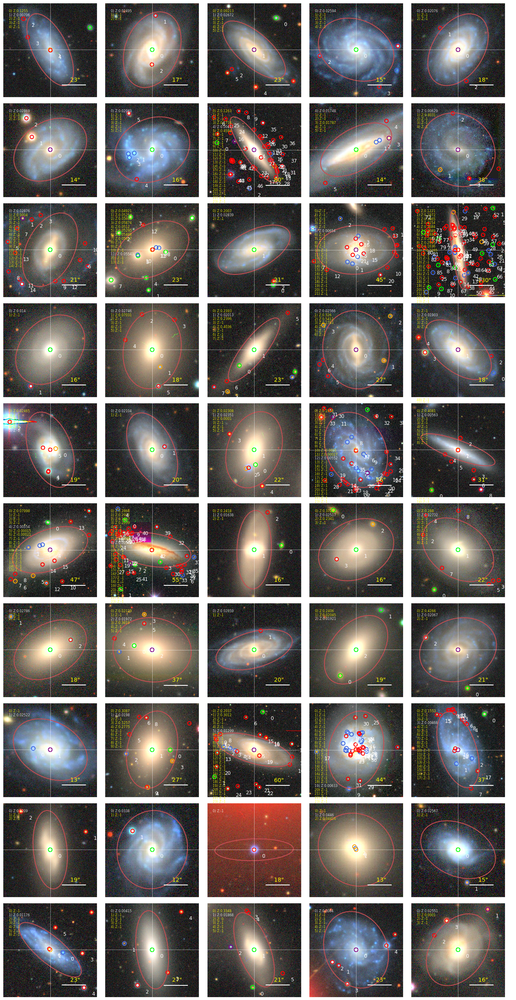

In [29]:
from postages_images import postages_circle

veto = {'bgs & gama':(tab['bgs']) & (tab['gama']),
        'bgs & ~gama':(tab['bgs']) & (~tab['gama']),
        '~bgs & gama & LS':(~tab['bgs']) & (tab['gama']) & (tab['dr8']),
        '~bgs & gama & ~LS':(~tab['dr8']) & (tab['gama'])  
       }
#veto = {'inLG':tab['lg'], 'outLG':~tab['lg']}
#info = {'Z':tab['Z'], 'isLG':tab['lgbit'].astype(str)}
info = {'Z':tab['Z']}
layer_dr8='dr8'
#'dr8-model'
#'dr8-resid'

#get indexes of LSLGA
magmin, magmax = 10, 15
LGMagMASK = (lslga['MAG'] < magmax) & (lslga['MAG'] > magmin) & (np.isfinite(lslga['PA']))
print('fraction of LSLGA: %i / %i' %(np.sum(LGMagMASK), len(lslga)))
LG_idx, radius_LG = inLSLGA(CAT=tab, LSLGA=lslga, LSLGA_MASK=LGMagMASK)

#if we want to compare the same objects with another catalogue (i.e., DR7, DR8) select only
#the right number of indexes as your grid to avoid the random selection in postages_circle.
postages_circle(coord=[tab['RA'], tab['DEC']], centeridx=LG_idx, veto=veto, info=info, scale=0.262, 
                scale_unit='pixscale', layer=layer_dr8, radius=radius_LG, m=1.2, grid=[10,5], 
                    savefile='%sLSLGA_mag_%.1f_%.1f' %(pathdir, magmin, magmax), layer2=None, layer2Mode='merge', 
                        isLG=True, title=None, markers=False, colorkey=True)


fraction of LSLGA: 2683 / 3937


Progress...N/A%|                                                    |

2333 nearby objects


Progress...100%|####################################################|


Colour key:
	 bgs & gama --> lime
	 bgs & ~gama --> royalblue
	 ~bgs & gama & LS --> purple
	 ~bgs & gama & ~LS --> orange
	 other --> red


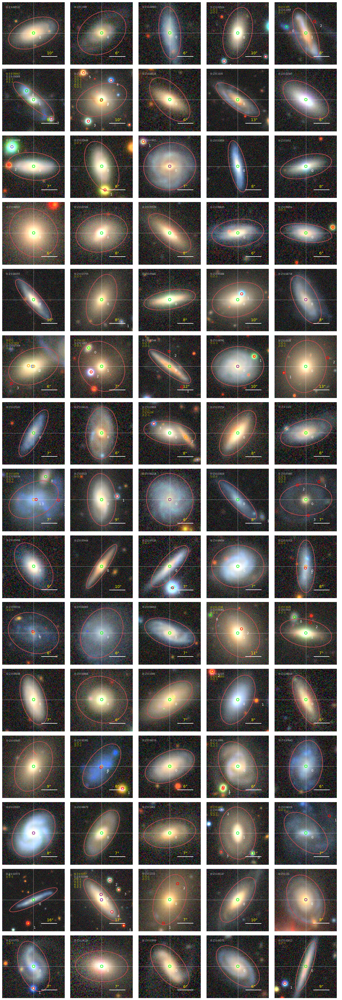

In [30]:
from postages_images import postages_circle

veto = {'bgs & gama':(tab['bgs']) & (tab['gama']),
        'bgs & ~gama':(tab['bgs']) & (~tab['gama']),
        '~bgs & gama & LS':(~tab['bgs']) & (tab['gama']) & (tab['dr8']),
        '~bgs & gama & ~LS':(~tab['dr8']) & (tab['gama'])  
       }
#veto = {'inLG':tab['lg'], 'outLG':~tab['lg']}
#info = {'Z':tab['Z'], 'isLG':tab['lgbit'].astype(str)}
info = {'Z':tab['Z']}
layer_dr8='dr8'
#'dr8-model'
#'dr8-resid'

#get indexes of LSLGA
magmin, magmax = 15, 18
LGMagMASK = (lslga['MAG'] < magmax) & (lslga['MAG'] > magmin) & (np.isfinite(lslga['PA']))
print('fraction of LSLGA: %i / %i' %(np.sum(LGMagMASK), len(lslga)))
LG_idx, radius_LG = inLSLGA(CAT=tab, LSLGA=lslga, LSLGA_MASK=LGMagMASK)

#if we want to compare the same objects with another catalogue (i.e., DR7, DR8) select only
#the right number of indexes as your grid to avoid the random selection in postages_circle.
postages_circle(coord=[tab['RA'], tab['DEC']], centeridx=LG_idx, veto=veto, info=info, scale=0.262, 
                scale_unit='pixscale', layer=layer_dr8, radius=radius_LG, m=1.2, grid=[15,5], 
                    savefile='%sLSLGA_mag_%.1f_%.1f' %(pathdir, magmin, magmax), layer2=None, layer2Mode='merge', 
                        isLG=True, title=None, markers=False, colorkey=True)


## gallery of LSLGA galaxies with resid

fraction of LSLGA: 413 / 3937


Progress...N/A%|                                                    |

331 nearby objects


Progress...100%|####################################################|


Colour key:
	 bgs & gama --> lime
	 bgs & ~gama --> royalblue
	 ~bgs & gama & LS --> purple
	 ~bgs & gama & ~LS --> orange
	 other --> red


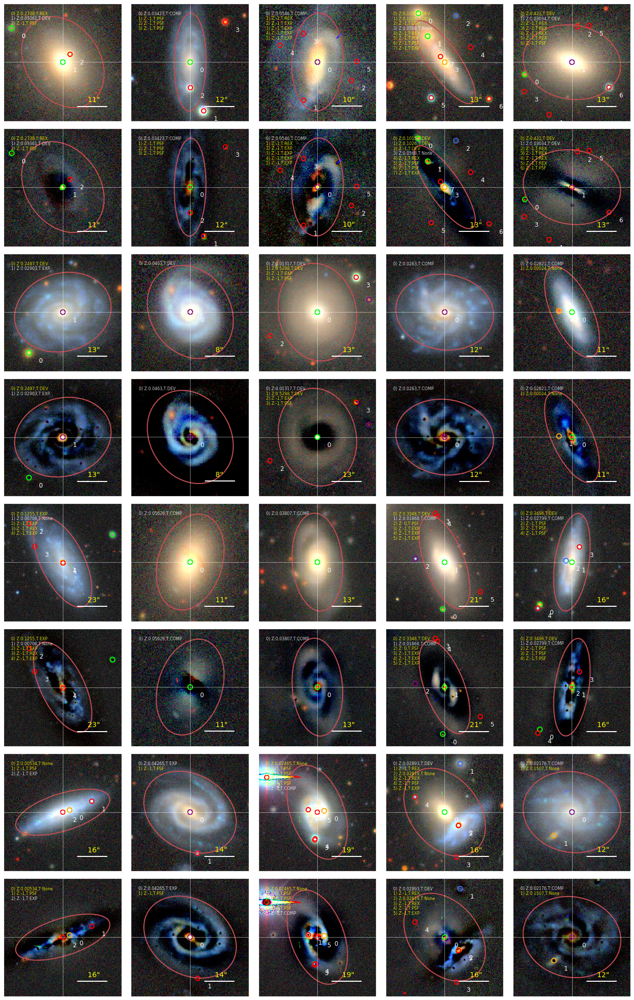

In [44]:
from postages_images import postages_circle

veto = {'bgs & gama':(tab['bgs']) & (tab['gama']),
        'bgs & ~gama':(tab['bgs']) & (~tab['gama']),
        '~bgs & gama & LS':(~tab['bgs']) & (tab['gama']) & (tab['dr8']),
        '~bgs & gama & ~LS':(~tab['dr8']) & (tab['gama'])  
       }
#veto = {'inLG':tab['lg'], 'outLG':~tab['lg']}
#info = {'Z':tab['Z'], 'isLG':tab['lgbit'].astype(str)}
info = {'Z':tab['Z'], 'T':tab['TYPE'].astype(str)}
layer_dr8='dr8'
#'dr8-model'
#'dr8-resid'

#get indexes of LSLGA
magmin, magmax = 13, 16
LGMagMASK = (lslga['MAG'] < magmax) & (lslga['MAG'] > magmin) & (np.isfinite(lslga['PA']))
print('fraction of LSLGA: %i / %i' %(np.sum(LGMagMASK), len(lslga)))
LG_idx, radius_LG = inLSLGA(CAT=tab, LSLGA=lslga, LSLGA_MASK=LGMagMASK)

#if we want to compare the same objects with another catalogue (i.e., DR7, DR8) select only
#the right number of indexes as your grid to avoid the random selection in postages_circle.
postages_circle(coord=[tab['RA'], tab['DEC']], centeridx=LG_idx, veto=veto, info=info, scale=0.262, 
                scale_unit='pixscale', layer=layer_dr8, radius=radius_LG, m=1.2, grid=[4,5], 
                    savefile='%sLSLGA_mag_%.1f_%.1f' %(pathdir, magmin, magmax), layer2='dr8-resid', layer2Mode='merge', 
                        isLG=True, title=None, markers=False, colorkey=True)


## example of objects not in LS & in GAMA

Progress...N/A%|                                                    |

sample size: 5330


Progress...100%|####################################################|


Colour key:
	 bgs & gama --> lime
	 bgs & ~gama --> royalblue
	 ~bgs & gama & LS --> purple
	 ~bgs & gama & ~LS --> orange
	 other --> red


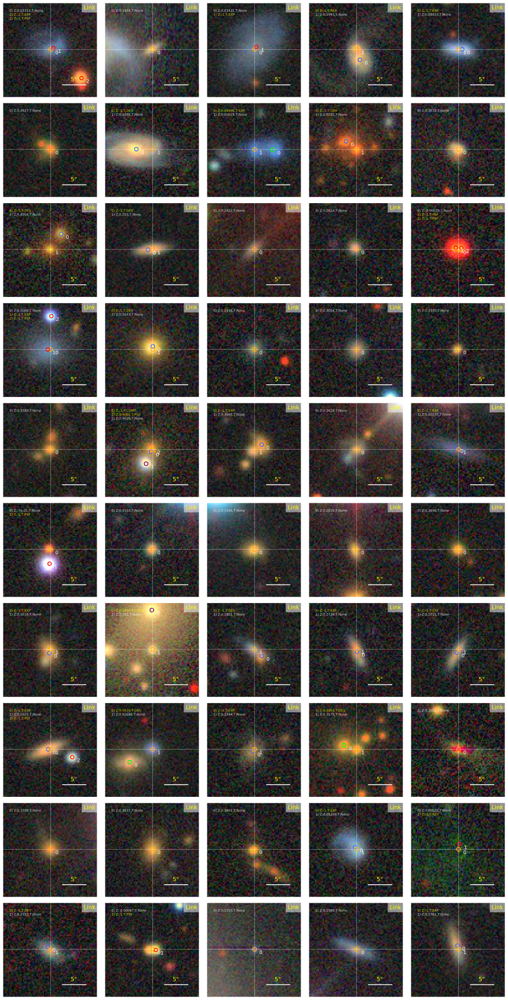

In [92]:
from postages_images import postages_circle

veto = {'bgs & gama':(tab['bgs']) & (tab['gama']),
        'bgs & ~gama':(tab['bgs']) & (~tab['gama']),
        '~bgs & gama & LS':(~tab['bgs']) & (tab['gama']) & (tab['dr8']),
        '~bgs & gama & ~LS':(~tab['dr8']) & (tab['gama'])  
       }
#veto = {'inLG':tab['lg'], 'outLG':~tab['lg']}
#info = {'Z':tab['Z'], 'isLG':tab['lgbit'].astype(str)}
info = {'Z':tab['Z'], 'T':tab['TYPE'].astype(str)}
layer_dr8='dr8'
#'dr8-model'
#'dr8-resid'

#get indexes of LSLGA
rpetromin, rpetromax = 18, 20
idx = list(np.where((~tab['dr8']) & (tab['gama']) & (tab['rpetro'] < rpetromax)  & (tab['rpetro'] > rpetromin)))[0]
print('sample size: %i' %(len(idx)))

#if we want to compare the same objects with another catalogue (i.e., DR7, DR8) select only
#the right number of indexes as your grid to avoid the random selection in postages_circle.
postages_circle(coord=[tab['RA'], tab['DEC']], centeridx=idx, veto=veto, info=info, scale=0.262, 
                scale_unit='pixscale', layer=layer_dr8, radius=5/3600., m=2, grid=[10,5], 
                    savefile='%sLSLGA_mag_not_in_LS_in_gama_rpetro_%.1f_%.1f' %(pathdir, rpetromin, rpetromax), layer2=None, layer2Mode='merge', 
                        isLG=False, title=None, markers=False, colorkey=True)


## example of objects with no-PSF bestfit with the LG bitmask

Progress...N/A%|                                                    |

sample size: 238


Progress...100%|####################################################|


Colour key:
	 inLG & PSF --> lime
	 inLG & NOPSF --> royalblue
	 outLG --> purple
	 other --> red


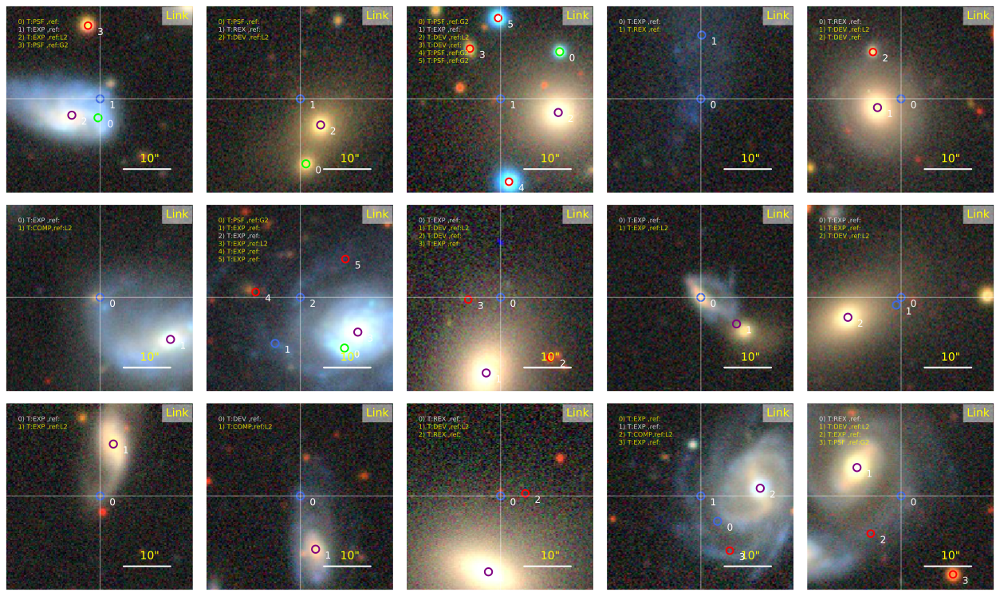

In [102]:
from postages_images import postages_circle

LG = ((np.uint64(dr8ingama['MASKBITS']) & np.uint64(2**12))!=0)
L2 = dr8ingama['REF_CAT'] == 'L2'
PSF = dr8ingama['TYPE'] == 'PSF '
NOPSF = dr8ingama['TYPE'] != 'PSF '

veto = {'inLG & PSF':(LG) & (PSF) & (~L2),
        'inLG & NOPSF':(LG) & (NOPSF) & (~L2),
        'outLG':L2
       }
#veto = {'inLG':tab['lg'], 'outLG':~tab['lg']}
#info = {'Z':tab['Z'], 'isLG':tab['lgbit'].astype(str)}
info = {'T':dr8ingama['TYPE'].astype(str), 'ref':dr8ingama['REF_CAT'].astype(str)}
layer_dr8='dr8'
#'dr8-model'
#'dr8-resid'

#get indexes of LSLGA
#rpetromin, rpetromax = 18, 20
idx = list(np.where(veto['inLG & NOPSF']))[0]
print('sample size: %i' %(len(idx)))

#if we want to compare the same objects with another catalogue (i.e., DR7, DR8) select only
#the right number of indexes as your grid to avoid the random selection in postages_circle.
postages_circle(coord=[dr8ingama['RA'], dr8ingama['DEC']], centeridx=idx, veto=veto, info=info, scale=0.262, 
                scale_unit='pixscale', layer=layer_dr8, radius=10/3600., m=2, grid=[3,5], 
                    savefile='%snon-PSF_within_LSLGA_mask' %(pathdir), layer2=None, layer2Mode='merge', 
                        isLG=False, title=None, markers=False, colorkey=True)


## example of LSLGA not in BGS and why these are not beeing selected

# DEV ZONE